# ツリーマップ

## 準備

### Import

In [1]:
# warningsモジュールのインポート
import warnings

# データ解析や機械学習のライブラリ使用時の警告を非表示にする目的で警告を無視
# 本書の文脈では、可視化の学習に議論を集中させるために選択した
# ただし、学習以外の場面で、警告を無視する設定は推奨しない
warnings.filterwarnings("ignore")

In [2]:
# itertoolsモジュールのインポート
# 効率的なループを実行するためのイテレータビルディングブロックを提供
# これにより、データのコンビネーションや順列などを簡潔に表現できる
import itertools

# pathlibモジュールのインポート
# ファイルシステムのパスを扱う
from pathlib import Path

# numpy：数値計算ライブラリのインポート
# npという名前で参照可能
import numpy as np

# pandas：データ解析ライブラリのインポート
# pdという名前で参照可能
import pandas as pd

# plotly.expressのインポート
# インタラクティブなグラフ作成のライブラリ
# pxという名前で参照可能
import plotly.express as px

# plotly.graph_objectsからFigureクラスのインポート
# 型ヒントの利用を主目的とする
from plotly.graph_objects import Figure

### 変数

In [3]:
# マンガデータ保存ディレクトリのパス
DIR_CM = Path("../../../data/cm/input")
# アニメデータ保存ディレクトリのパス
DIR_AN = Path("../../../data/an/input")
# ゲームデータ保存ディレクトリのパス
DIR_GM = Path("../../../data/gm/input")

# マンガデータの分析結果の出力先ディレクトリのパス
DIR_OUT_CM = (
    DIR_CM.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "tree"
)
# アニメデータの分析結果の出力先ディレクトリのパス
DIR_OUT_AN = (
    DIR_AN.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "tree"
)
# ゲームデータの分析結果の出力先ディレクトリのパス
DIR_OUT_GM = (
    DIR_GM.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "tree"
)

In [4]:
# 読み込み対象ファイル名の定義

# マンガ作品とマンガ作者の対応関係に関するファイル
FN_CC_CRT = "cm_cc_crt.csv"

# マンガ各話に関するファイル
FN_CE = "cm_ce.csv"

# アニメ作品と原作者の対応関係に関するファイル
FN_AC_ACT = "an_ac_act.csv"

# アニメ各話に関するファイル
FN_AE = "an_ae.csv"

# ゲームパッケージとプラットフォームの対応関係に関するファイル
FN_PKG_PF = "gm_pkg_pf.csv"

In [5]:
# 可視化に関する設定値の定義

# 「年代」の集計単位
UNIT_YEARS = 10

In [6]:
# plotlyの描画設定の定義

# plotlyのグラフ描画用レンダラーの定義
# Jupyter Notebook環境のグラフ表示に適切なものを選択
RENDERER = "plotly_mimetype+notebook"

In [7]:
# 国内主要ゲームメーカーのプラットフォームとメーカー名の対応辞書
# キー: プラットフォーム名、値: メーカー名の略称
PF2MK = {
    "プレイステーション": "ソニー",
    "プレイステーション2": "ソニー",
    "プレイステーション・ポータブル": "ソニー",
    "プレイステーション3": "ソニー",
    "プレイステーションVita": "ソニー",
    "プレイステーション4": "ソニー",
    "ゲームアーカイブス": "ソニー",
    "SG-1000": "セガ",
    "SC-3000": "セガ",
    "SEGAマーク3": "セガ",
    "セガ・マスターシステム": "セガ",
    "メガドライブ": "セガ",
    "ゲームギア": "セガ",
    "セガサターン": "セガ",
    "ドリームキャスト": "セガ",
    "ファミリーコンピュータ": "任天堂",
    "ゲームボーイ": "任天堂",
    "スーパーファミコン": "任天堂",
    "NINTENDO64": "任天堂",
    "ゲームボーイアドバンス": "任天堂",
    "ニンテンドーゲームキューブ": "任天堂",
    "ニンテンドーDS": "任天堂",
    "ニンテンドー3DS": "任天堂",
    "Wii": "任天堂",
    "WiiU": "任天堂",
    "NintendoSwitch": "任天堂",
}

In [8]:
# pandasのweekday関数で取得できる曜日の数値と実際の曜日名を対応させる辞書を定義
# 0:月曜日, 1:火曜日, ... , 6:日曜日
WEEKDAY2YOBI = {
    0: "月",
    1: "火",
    2: "水",
    3: "木",
    4: "金",
    5: "土",
    6: "日",
}

In [9]:
# 質的変数の描画用のカラースケールの定義

# Okabe and Ito (2008)基準のカラーパレット
# 色の識別性が高く、多様な色覚の人々にも見やすい色組み合わせ
# 参考URL: https://jfly.uni-koeln.de/color/#pallet
OKABE_ITO = [
    "#000000",  # 黒 (Black)
    "#E69F00",  # 橙 (Orange)
    "#56B4E9",  # 薄青 (Sky Blue)
    "#009E73",  # 青緑 (Bluish Green)
    "#F0E442",  # 黄色 (Yellow)
    "#0072B2",  # 青 (Blue)
    "#D55E00",  # 赤紫 (Vermilion)
    "#CC79A7",  # 紫 (Reddish Purple)
]

### 関数

In [10]:
def show_fig(fig: Figure) -> None:
    """
    所定のレンダラーを用いてplotlyの図を表示
    Jupyter Bookなどの環境での正確な表示を目的とする

    Parameters
    ----------
    fig : Figure
        表示対象のplotly図

    Returns
    -------
    None
    """

    # 図の周囲の余白を設定
    # t: 上余白
    # l: 左余白
    # r: 右余白
    # b: 下余白
    fig.update_layout(margin=dict(t=25, l=25, r=25, b=25))

    # 所定のレンダラーで図を表示
    fig.show(renderer=RENDERER)

In [11]:
def add_years_to_df(
    df: pd.DataFrame, unit_years: int = UNIT_YEARS, col_date: str = "date"
) -> pd.DataFrame:
    """
    データフレームにunit_years単位で区切った年数を示す新しい列を追加

    Parameters
    ----------
    df : pd.DataFrame
        入力データフレーム
    unit_years : int, optional
        年数を区切る単位、デフォルトはUNIT_YEARS
    col_date : str, optional
        日付を含むカラム名、デフォルトは "date"

    Returns
    -------
    pd.DataFrame
        新しい列が追加されたデータフレーム
    """

    # 入力データフレームをコピー
    df_new = df.copy()

    # unit_years単位で年数を区切り、新しい列として追加
    df_new["years"] = (
        pd.to_datetime(df_new[col_date]).dt.year // unit_years * unit_years
    )

    # 'years'列のデータ型を文字列に変更
    df_new["years"] = df_new["years"].astype(str)

    return df_new

In [12]:
def save_df_to_csv(df: pd.DataFrame, dir_save: Path, fn_save: str) -> None:
    """
    DataFrameをCSVファイルとして指定されたディレクトリに保存する関数

    Parameters
    ----------
    df : pd.DataFrame
        保存対象となるDataFrame
    dir_save : Path
        出力先ディレクトリのパス
    fn_save : str
        保存するCSVファイルの名前（拡張子は含めない）
    """
    # 出力先ディレクトリが存在しない場合は作成
    dir_save.mkdir(parents=True, exist_ok=True)

    # 出力先のパスを作成
    p_save = dir_save / f"{fn_save}.csv"

    # DataFrameをCSVファイルとして保存する
    df.to_csv(p_save, index=False, encoding="utf-8-sig")

    # 保存完了のメッセージを表示する
    print(f"DataFrame is saved as '{p_save}'.")

## 可視化例

### マンガデータ

In [13]:
# pandasのread_csv関数でCSVファイルの読み込み
df_cc_crt = pd.read_csv(DIR_CM / FN_CC_CRT)

In [14]:
# 可視化用の前処理のためデータフレームをコピー
df_cm = df_cc_crt.copy()

# 可視化対象として利用する列とその表示名
cols_cm = {
    "mcname": "マンガ雑誌名",
    "crtname": "マンガ作者名",
    "ccname": "マンガ作品名",
    "n_ce": "マンガ各話数",
}

# 可視化対象の列のみ抽出
df_cm = df_cm[cols_cm.keys()]

# 列名をわかりやすく変更
df_cm = df_cm.rename(columns=cols_cm)

In [15]:
# 可視化対象のDataFrameを確認
df_cm.head()

,マンガ雑誌名,マンガ作者名,マンガ作品名,マンガ各話数
0,週刊少年ジャンプ,山止たつひこ,交通安全'76,1
1,週刊少年ジャンプ,柳田東一郎,好敵手 室伏広治物語,1
2,週刊少年ジャンプ,門脇正法,好敵手 室伏広治物語,1
3,週刊少年ジャンプ,富沢順,鋼鉄の殺人者,1
4,週刊少年ジャンプ,本宮ひろ志,硬派山崎銀次郎,1


In [16]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_cm, DIR_OUT_CM, "cm")

DataFrame is saved as '../../../data/cm/output/vol2/03/tree/cm.csv'.


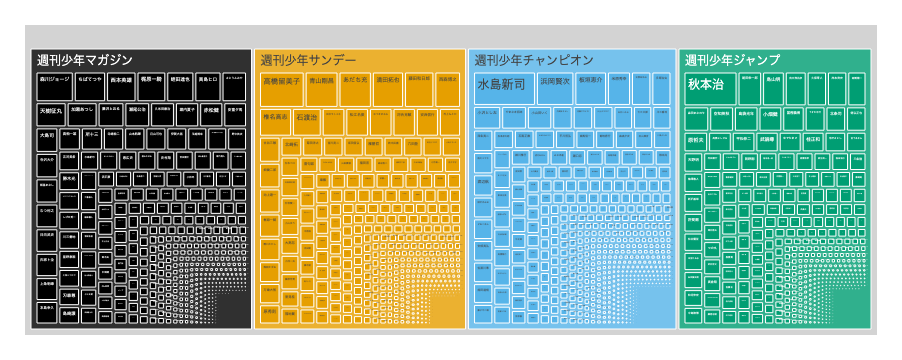

In [17]:
# px.treemapでツリーマップを作成
# df_cmに対して、pathの順序でツリーの階層を構築
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_cm,
    path=["マンガ雑誌名", "マンガ作者名"],
    values="マンガ各話数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

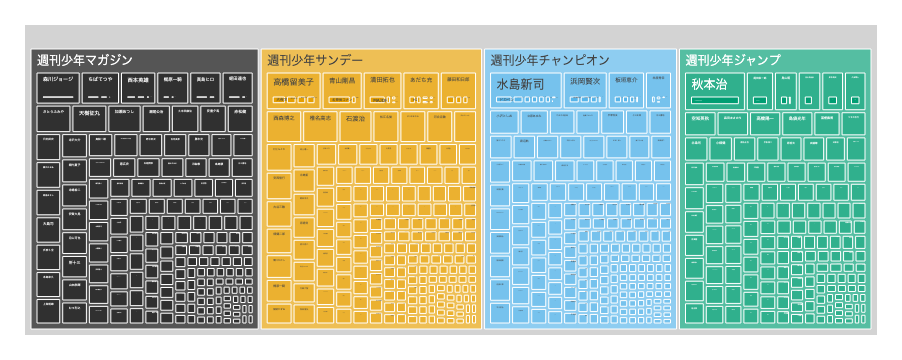

In [18]:
# px.treemapでツリーマップを作成
# df_cmに対して、pathの順序でツリーの階層を構築（先程と比較して、マンガ作品名を追加）
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
# なお、表示が細かくなりすぎないよう、各話数が50以上のマンガ作品に限定
fig = px.treemap(
    df_cm[df_cm["マンガ各話数"] >= 50],
    path=["マンガ雑誌名", "マンガ作者名", "マンガ作品名"],
    values="マンガ各話数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

### アニメデータ

In [19]:
# pandasのread_csv関数でCSVファイルの読み込み
df_ac_act = pd.read_csv(DIR_AN / FN_AC_ACT)

In [20]:
# 可視化用の集計
# df_ac_actをコピー
df_an = df_ac_act.copy()

# 各声優が本データ中に最初に登場した年を集計
df_an["first_date"] = pd.to_datetime(df_an["first_date"])
# actname2fyearに声優名を初登場年の対応関係を格納
actname2fyear = df_an.groupby("actname")["first_date"].first().dt.year.to_dict()
# df_anの`first_year`列に声優としての初登場年を追加
df_an["first_year"] = df_an["actname"].map(actname2fyear)

# 可視化に用いる列とその表示名
cols_an = {
    "acname": "アニメ作品名",
    "n_ae": "アニメ各話数",
    "actname": "声優名",
    "gender": "性別",
    "first_year": "初登場年",
}
# 可視化に用いる列のみ残す
df_an = df_an[cols_an.keys()]
# 可視化用に列名を変更
df_an = df_an.rename(columns=cols_an)

In [21]:
# 可視化対象のDataFrameを確認
df_an.head()

,アニメ作品名,アニメ各話数,声優名,性別,初登場年
0,ギャラクシー エンジェル,24,かないみか,female,2001
1,ギャラクシー エンジェル,24,保村真,male,2001
2,ギャラクシー エンジェル,24,吉野裕行,male,2001
3,ギャラクシー エンジェル,24,山口眞弓,female,2001
4,ギャラクシー エンジェル,24,新谷良子,female,2001


In [22]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_an, DIR_OUT_AN, "an")

DataFrame is saved as '../../../data/an/output/vol2/03/tree/an.csv'.


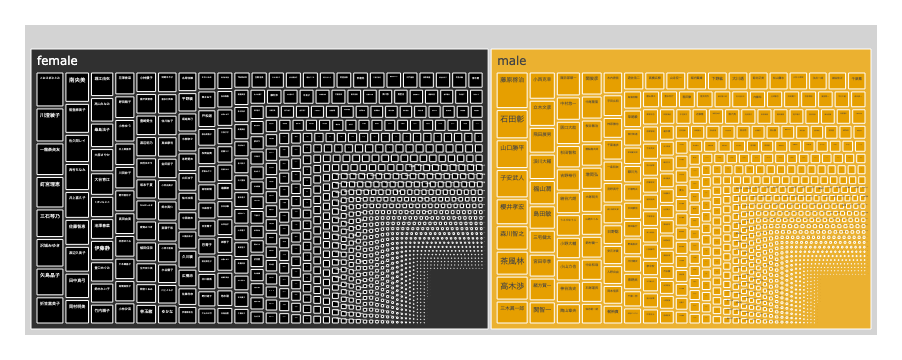

In [23]:
# px.treemapでツリーマップを作成
# df_anに対して、pathの順序でツリーの階層を構築
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_an,
    path=["性別", "声優名"],
    values="アニメ各話数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

In [24]:
# データサイズを圧縮するため、合計アニメ各話数が多い100名の声優を抽出

# 声優名別の合計アニメ各話数を集計し、df_tmpとして格納
df_tmp = df_an.groupby("声優名")["アニメ各話数"].sum().reset_index()
# 合計アニメ各話数で降順にソート
df_tmp = df_tmp.sort_values("アニメ各話数", ascending=False, ignore_index=True)
# 上位100名の声優名を抽出し、リストとして格納
actnames = df_tmp["声優名"].head(100).unique().tolist()

# 上記の声優名リストに含まれるレコードのみ抽出
df_an2 = df_an[df_an["声優名"].isin(actnames)].reset_index(drop=True)

In [25]:
# 可視化対象のDataFrameを確認
df_an2.head()

,アニメ作品名,アニメ各話数,声優名,性別,初登場年
0,ギャラクシー エンジェル,24,吉野裕行,male,2001
1,ギャラクシー エンジェル,24,沢城みゆき,female,2001
2,ギャラクシー エンジェル,24,田村ゆかり,female,2001
3,ギャラクシー エンジェル,24,藤原啓治,male,2001
4,ギャラクシー エンジェル,24,陶山章央,male,2001


In [26]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_an2, DIR_OUT_AN, "an2")

DataFrame is saved as '../../../data/an/output/vol2/03/tree/an2.csv'.


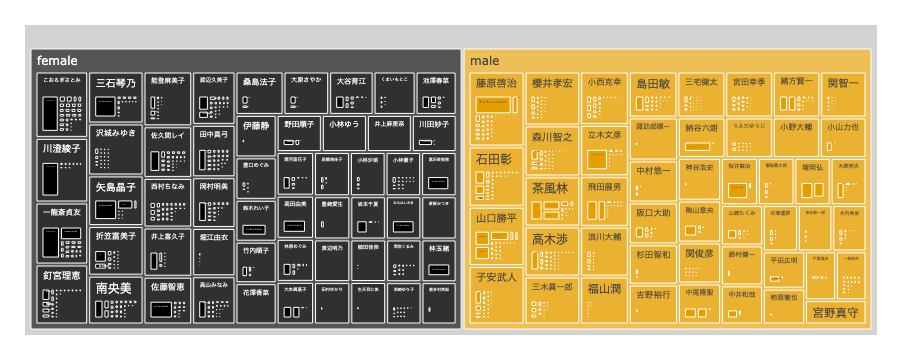

In [27]:
# px.treemapでツリーマップを作成
# df_anに対して、pathの順序でツリーの階層を構築
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_an2,
    path=["性別", "声優名", "アニメ作品名"],
    values="アニメ各話数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

### ゲームデータ

In [28]:
# pandasのread_csv関数でCSVファイルの読み込み
df_pkg_pf = pd.read_csv(DIR_GM / FN_PKG_PF)

In [29]:
# 曜日ごとのパッケージ数を集計するためのデータ前処理

# date列をdatetimeオブジェクトに変換して、曜日情報を新たな列としてdf_pkg_pfに追加
df_pkg_pf["weekday"] = pd.to_datetime(df_pkg_pf["date"]).dt.weekday

# 曜日ごとにユニークなパッケージIDの数を集計
df_gm = (
    df_pkg_pf.groupby(["pfname", "weekday", "publisher"])["pkgid"]
    .nunique()
    .reset_index(name="n_pkg")
)

# 数値で表されている曜日を文字列にマッピング
df_gm["yobi"] = df_gm["weekday"].apply(lambda x: WEEKDAY2YOBI.get(x, None))

# 列名をリネーム
df_gm = df_gm.rename(
    columns={
        "n_pkg": "パッケージ数",
        "yobi": "曜日",
        "pfname": "プラットフォーム名",
        "publisher": "パブリッシャー名",
    }
)

In [30]:
# 可視化対象のDataFrameを確認
df_gm.head()

,プラットフォーム名,weekday,パブリッシャー名,パッケージ数,曜日
0,3DO,0,株式会社ワープ,2,月
1,3DO,2,株式会社マイクロキャビン,1,水
2,3DO,2,株式会社マイクロネット,2,水
3,3DO,2,株式会社リバーヒルソフト,1,水
4,3DO,3,イマジニア株式会社,1,木


In [31]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_gm, DIR_OUT_GM, "gm")

DataFrame is saved as '../../../data/gm/output/vol2/03/tree/gm.csv'.


(tree-gm-example)=

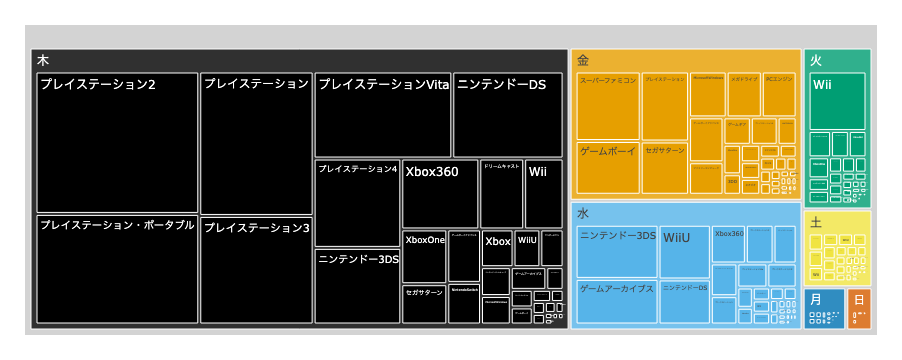

In [32]:
# px.treemapでツリーマップを作成
# df_gmに対して、pathの順序でツリーの階層を構築
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_gm,
    path=["曜日", "プラットフォーム名"],
    values="パッケージ数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

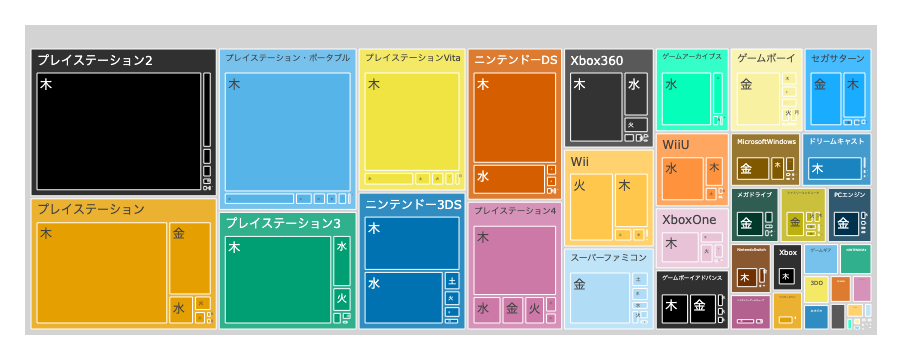

In [33]:
# px.treemapでツリーマップを作成
# df_gmに対して、pathの順序でツリーの階層を構築（プラットフォーム名と曜日の順序を変更）
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_gm,
    path=["プラットフォーム名", "曜日"],
    values="パッケージ数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)

In [34]:
# データサイズを圧縮するため、PF2MKに含まれるプラットフォームのみ抽出
df_gm2 = df_gm[df_gm["プラットフォーム名"].isin(PF2MK.keys())].reset_index(drop=True)
# pf2mkを利用し、df_gm2にメーカー名列を追加
df_gm2["メーカー名"] = df_gm2["プラットフォーム名"].map(PF2MK)

In [35]:
# 可視化対象のDataFrameを確認
df_gm2.head()

,プラットフォーム名,weekday,パブリッシャー名,パッケージ数,曜日,メーカー名
0,NINTENDO64,0,任天堂株式会社,2,月,任天堂
1,NINTENDO64,1,任天堂株式会社,2,火,任天堂
2,NINTENDO64,1,株式会社メディアファクトリー,1,火,任天堂
3,NINTENDO64,2,コナミ株式会社,2,水,任天堂
4,NINTENDO64,2,任天堂株式会社,4,水,任天堂


In [36]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_gm2, DIR_OUT_GM, "gm2")

DataFrame is saved as '../../../data/gm/output/vol2/03/tree/gm2.csv'.


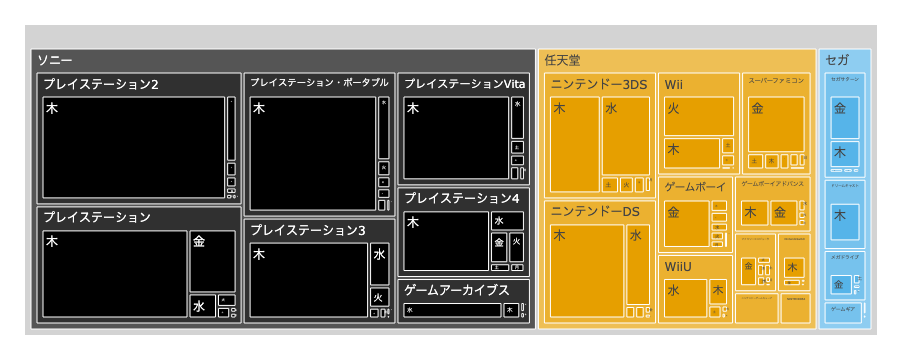

In [37]:
# px.treemapでツリーマップを作成
# df_gmに対して、pathの順序でツリーの階層を構築（メーカー名を追加）
# values列で指定した数量に応じて矩形の面積を調整
# color_discrete_sequenceで配色を指定
fig = px.treemap(
    df_gm2,
    path=["メーカー名", "プラットフォーム名", "曜日"],
    values="パッケージ数",
    color_discrete_sequence=OKABE_ITO,
)

# 全体の背景色としてlightgreyを選択
fig.update_traces(root_color="lightgrey")

# treemapを表示
show_fig(fig)